# Mock Image Pipeline Script

This notebook walks you through the pipeline for making a mock 3-color telescope image. The general step by step process is outlined below.

1. Start with the FITS file output of a SKIRT simulation which was run with present band pass instruments.
2. Once the FITS data is loaded, convolve the image over a point spread function (PSF) to imitate the smoothing of an instruments light.
3. Add in base noise to approximate the minimum brightness the telescope can detect with good signal to noise (S/N).
4. Create a RGB 3-color image from 3 broad band images.


**TO DO**

Add options to inject background noise.

Add options to downsample SKIRT instrument resolution to resolution of specified telescope.

**CAUTION**

Making 3 color images is as much an art as it is a science. Tweaking parameters can feel futile and the colors may never seem quite right.
The best advice I received from an observer is you will never reproduce the beauty and vividness of real Hubble images. It's ok to be satisfied with good enough.

First run SKIRT with the provided example file in the notebook directory. This will make a face on image of a z=0 galaxy with numerous well know telescope filters. I recommend m12i snapshot 600 to start with. You can use the `data_reduction.ipynb` notebook to reduce the snapshot data for SKIRT.

In [3]:
%load_ext autoreload
%autoreload 2

from crc_scripts.utils.SKIRT.instrument import SKIRT_Instrument, Telescope_PSF
from crc_scripts.figure import Figure,Projection

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Load the FITS file

Set the name of directory for the SKRIT outputs and the name of the instrument FITS file we will be making images from.

When the FITS file is read it will tell you some useful information like pixel resolution, FOV size, and the photometric images contained in the file.

In [35]:
# Define the SKIRT output directory and the name of the instrument FITS file
dirc = '/N/project/choban_group/cchoban/SKIRT_Hubble/output/'
inst_file = 'out_hubble_total.fits'

dirc = '/N/project/choban_group/aguzmano/FIRE2/m12i_res7100/live_dust/voronoi/snapdir_600/'
inst_file = 'run_broadband_xy_total.fits'

# Load the specified SKIRT instrument
inst = SKIRT_Instrument(dirc, inst_file, verbose=True)

FITS files info
Filename: /N/project/choban_group/aguzmano/FIRE2/m12i_res7100/live_dust/voronoi/snapdir_600/run_broadband_xy_total.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      32   (2210, 2210, 30)   float32   
  1  Z-axis coordinate values    1 TableHDU        13   30R x 1C   ['E16.9']   
None
SIMPLE  =                    T / file does conform to FITS standard             BITPIX  =                  -32 / number of bits per data pixel                  NAXIS   =                    3 / number of data axes                            NAXIS1  =                 2210 / length of data axis 1                          NAXIS2  =                 2210 / length of data axis 2                          NAXIS3  =                   30 / length of data axis 3                          EXTEND  =                    T / FITS dataset may contain extensions            COMMENT   FITS (Flexible Image Transport System) format is defined in 'AstronomyCOMME

## Make an SDSS UGR image

To start, we will make a nice RGB image using the SDSS u, g, and r filters.


In [46]:
# These are the filters we will use for the RGB parts of the image
rgb_filters = ['SLOAN_SDSS_R', 'SLOAN_SDSS_G', 'SLOAN_SDSS_U']

### Making a Lupton ArchSinh RGB image

This image will follow the Lupton et al (2004) scheme for RGB images which uses an arcsinh function to stretch the dynamic range and clips bright pixels so they keep their true color instead of being saturated. For example instead of RGB being clipped to (1,1,1) if it is over the max brightness, it is set such that it keeps the ratio between the three colors.

**Warning** 

The pixel brightness units matter. Lupton et al. (2004) recomends Q = 8 and stretch = 0.5, which works well for MJy / sr units (i.e. per-frequency surface brightness).

All examples below use the per-frequency brightness, since the example SKIRT instrument is in these units. This will make the galaxy look orange.

For per wavelength pixel brightness units, you need to set the stretch extremely low. Example for this are shown in the next section.

Image brightness is in terms of frequency with units MJy / sr
Image brightness is in terms of frequency with units MJy / sr
Image brightness is in terms of frequency with units MJy / sr


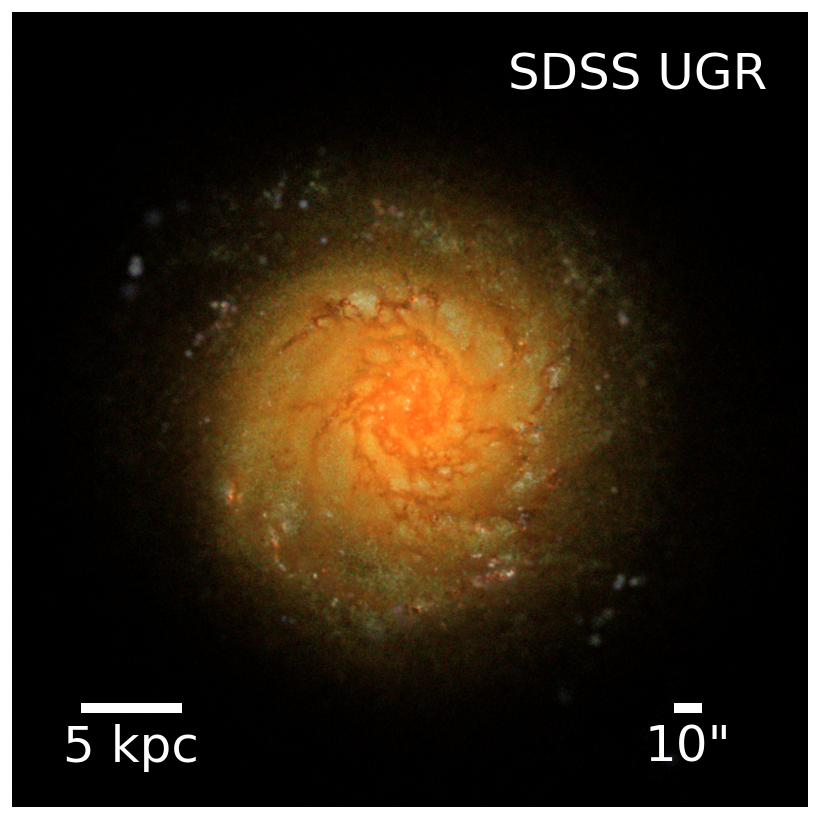

In [132]:
# The stretch parameter set the linear range of the image and Q brings out the brighter features
# Lupton recommends setting Q->0 and adjusting the stretch first and then Q
stretch=0.3 # smaller values increase the dynamic range. If your image is black set this very small 
Q=8 # This sets the brightest parts of the image
minimum=0 # This sets the minimum pixel value that is clipped to black
label='SDSS UGR'
inst.make_lupton_RGB_image(rgb_filters, stretch = stretch, Q=Q, minimum=minimum, brightness_units='frequency', label=label, output_name=None)

It can be hard to determine what Q and stretch parameter look best.
The following function will make a grid of images with different Q and stretch values to make this easier



Image brightness is in terms of frequency with units MJy / sr
Image brightness is in terms of frequency with units MJy / sr
Image brightness is in terms of frequency with units MJy / sr


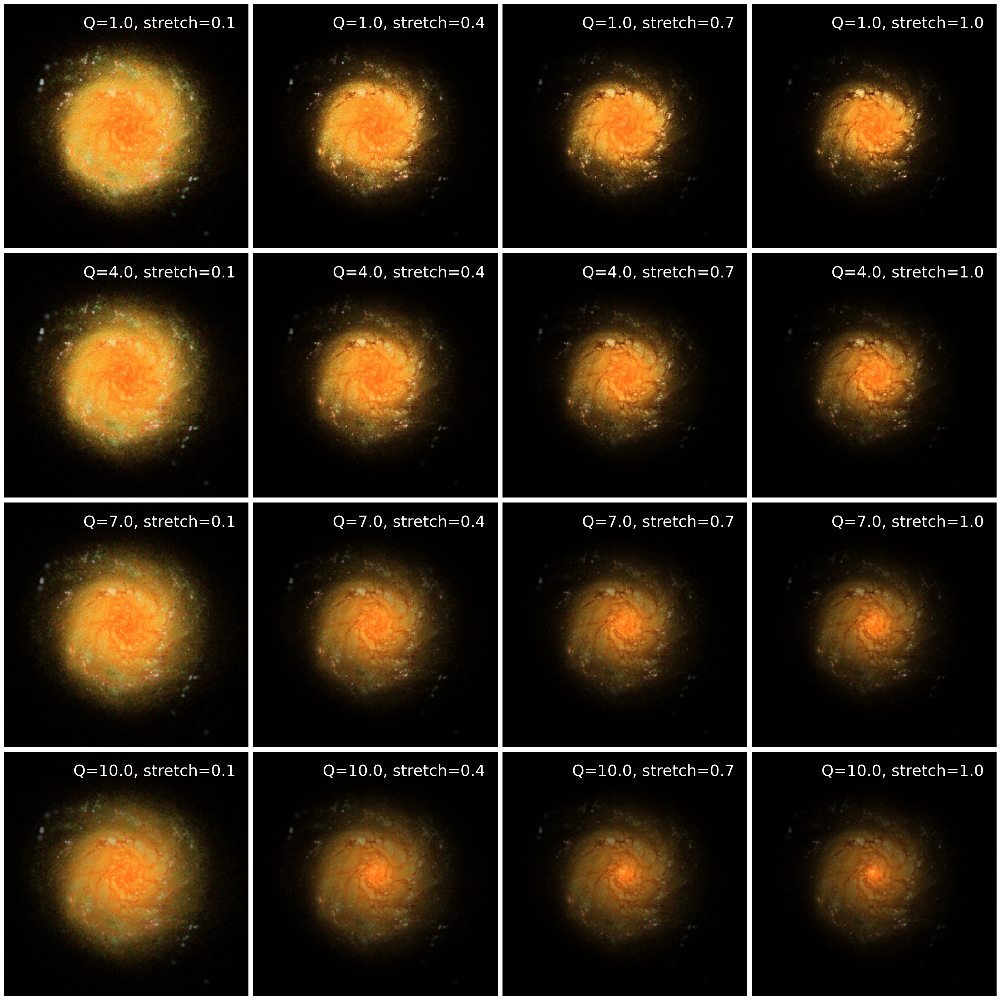

In [133]:
inst.make_lupton_RGB_image_grid(rgb_filters, brightness_units='frequency', Q_lims=[1,10], stretch_lims=[0.1,1], bins=4)

### Making a Lupton Log RGB Image

Maybe the arcsinh stretch isn't your fancy. You can also try making the image with log stretch as shown below.



SLOAN_SDSS_R image brightness is in terms of frequency with units MJy / sr
SLOAN_SDSS_G image brightness is in terms of frequency with units MJy / sr
SLOAN_SDSS_U image brightness is in terms of frequency with units MJy / sr
RGB maximum values [22.869359846115493, 0.9534216324985013, 0.7607056260108939]
RGB minimum values [0.00429534213617444, 0.0022321230731904506, 0.0006807086174376309]
SLOAN_SDSS_R image brightness is in terms of frequency with units MJy / sr
SLOAN_SDSS_G image brightness is in terms of frequency with units MJy / sr
SLOAN_SDSS_U image brightness is in terms of frequency with units MJy / sr
RGB maximum values [238.29202880859376, 232.1646240234375, 202.2631072998047]
RGB minimum values [0.0, 0.0, 0.0]


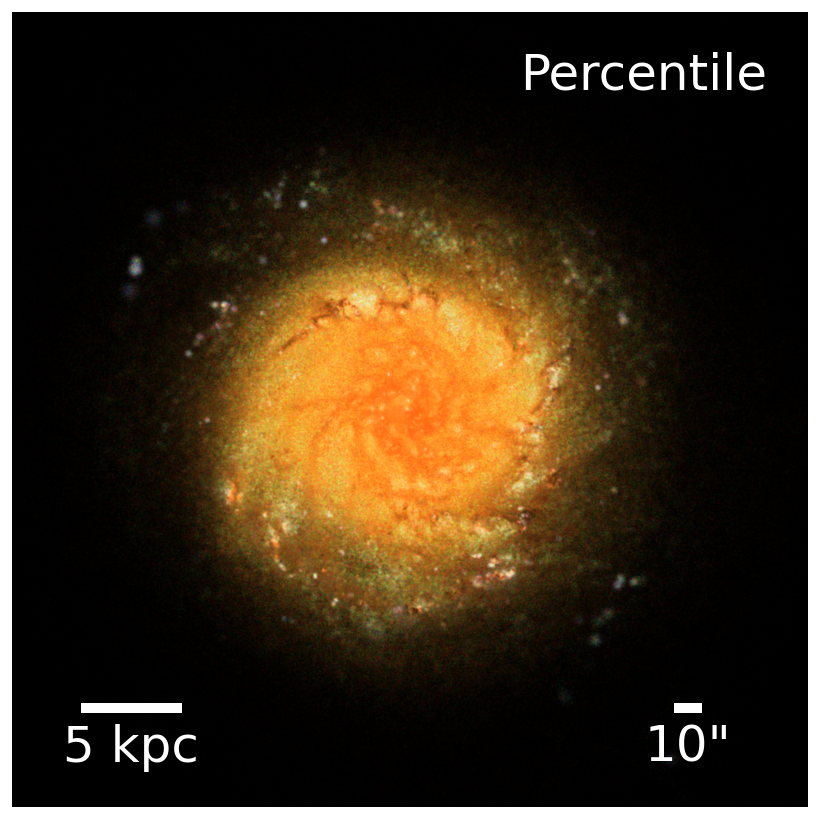

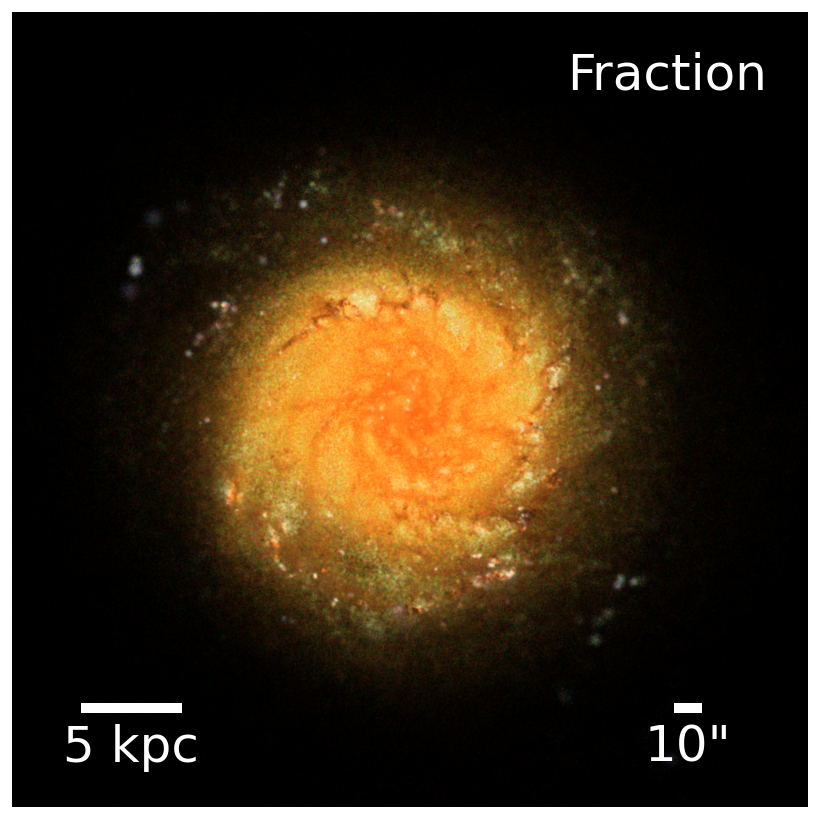

In [143]:
# To set the range of the log image you can either set the limits via percentiles or fractions of the maximum brightness
# Both are finicky and you will need to play around with them

# Set the max and min percentile for each filter. This ignore pixels with no brightness
# This can be either one value for all filters or individual values for each filter
max_percentile = [99.95,95.95,99.] 
min_percentile = [30,30,30]

# You can also set the minimum and maximum as fractions of the maximum 
# This is harder to tune since the the brightness pixel can be orders of magnitude brighter than the rest of the galaxy
max_frac = [0.9,0.9,0.9]
min_frac = 0

# Set the orders of magnitude you want to stretch 
stretch = 10
label='Percentile'
inst.make_log_lupton_RGB_image(rgb_filters, max_percentile = max_percentile, min_percentile = min_percentile,  stretch = stretch, brightness_units='frequency', label=label, output_name=None)

label = 'Fraction'
inst.make_log_lupton_RGB_image(rgb_filters, max_percentile = None, min_percentile=None, max_frac = max_frac, min_frac = min_frac, stretch = stretch, brightness_units='frequency', label=label, output_name=None)

To aid in determining the log limits you can look at a cumulative distribution function of the individual color channels as show below.

SLOAN_SDSS_R image brightness is in terms of frequency with units MJy / sr
SLOAN_SDSS_G image brightness is in terms of frequency with units MJy / sr
SLOAN_SDSS_U image brightness is in terms of frequency with units MJy / sr


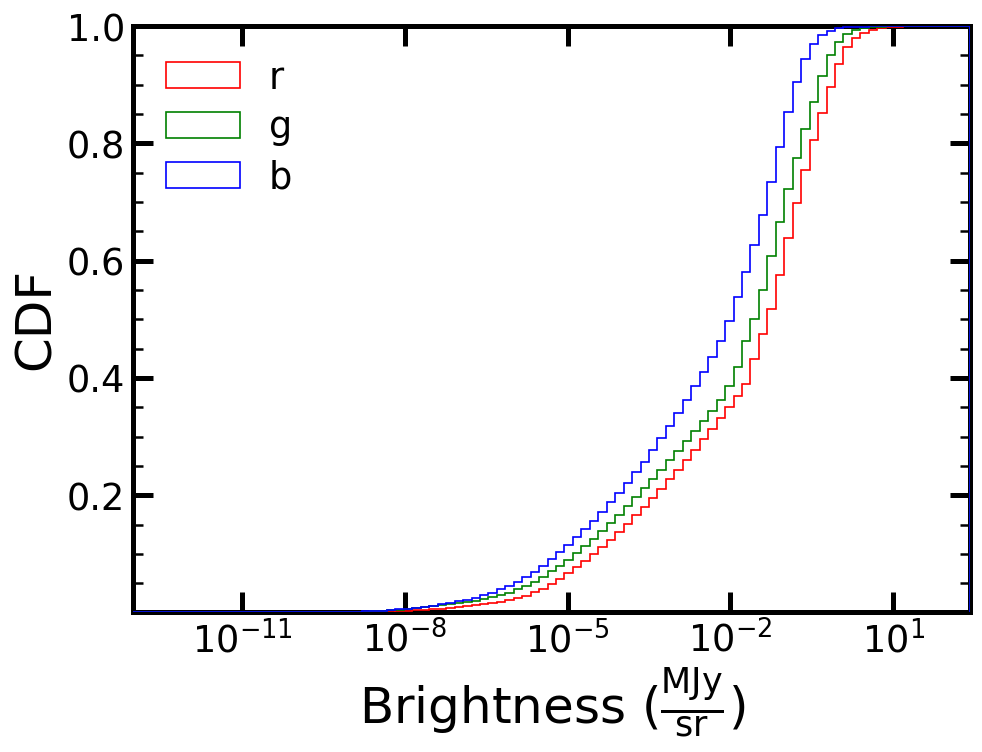

In [142]:
inst.make_rgb_hist(rgb_filters, brightness_units='frequency')

## Using Different Surface Brightness Units

Observers typically use different surface brightness units depending on the observed wavelengths. Radio uses MJy/steradian (F_nu), optical uses ergs/s/cm^2/Angstrom/arcsec^2 (F_lambda), etc. There is also neutral units (nu F_nu = lambda F_lambda). 

Using different surface brightness units can change the dominant colors and requires retuning the RGB parameters. For Lupton this means typcially means changing the stretch.

Below we will compare converting to different surface brightness units.

First we will compare the histograms of RGB values to see how the min and max vary considerably.

Image brightness is in terms of frequency with units MJy / sr
Image brightness is in terms of frequency with units MJy / sr
Image brightness is in terms of frequency with units MJy / sr
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (Angstrom s sr cm2).
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (Angstrom s sr cm2).
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (Angstrom s sr cm2).
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (s sr cm2).
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (s sr cm2).
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (s sr cm2).


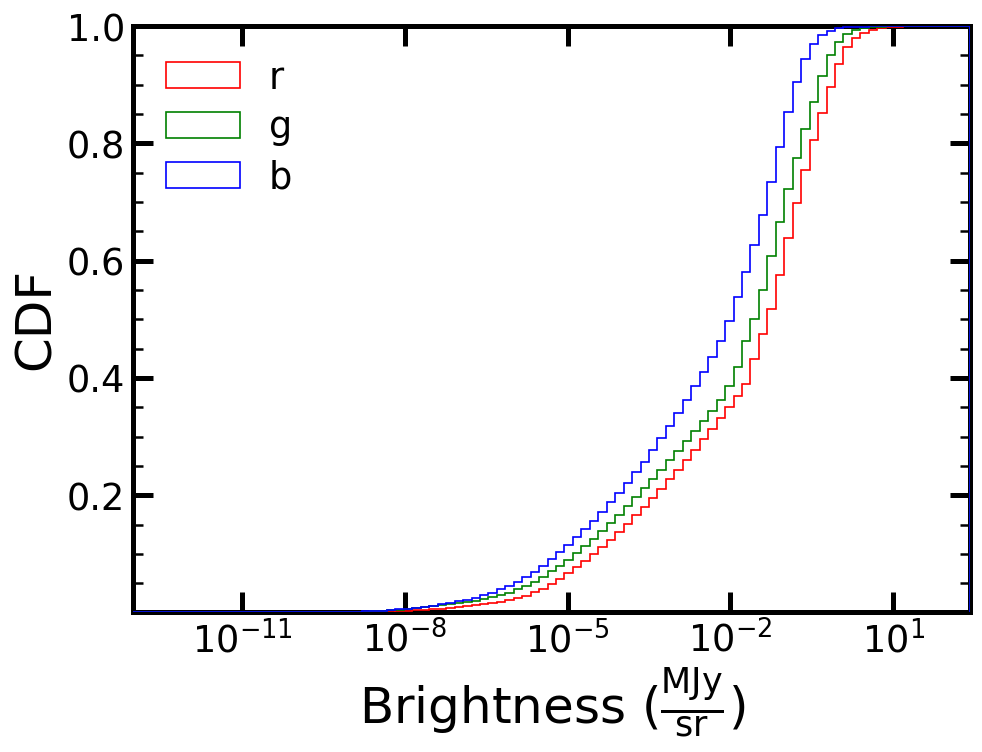

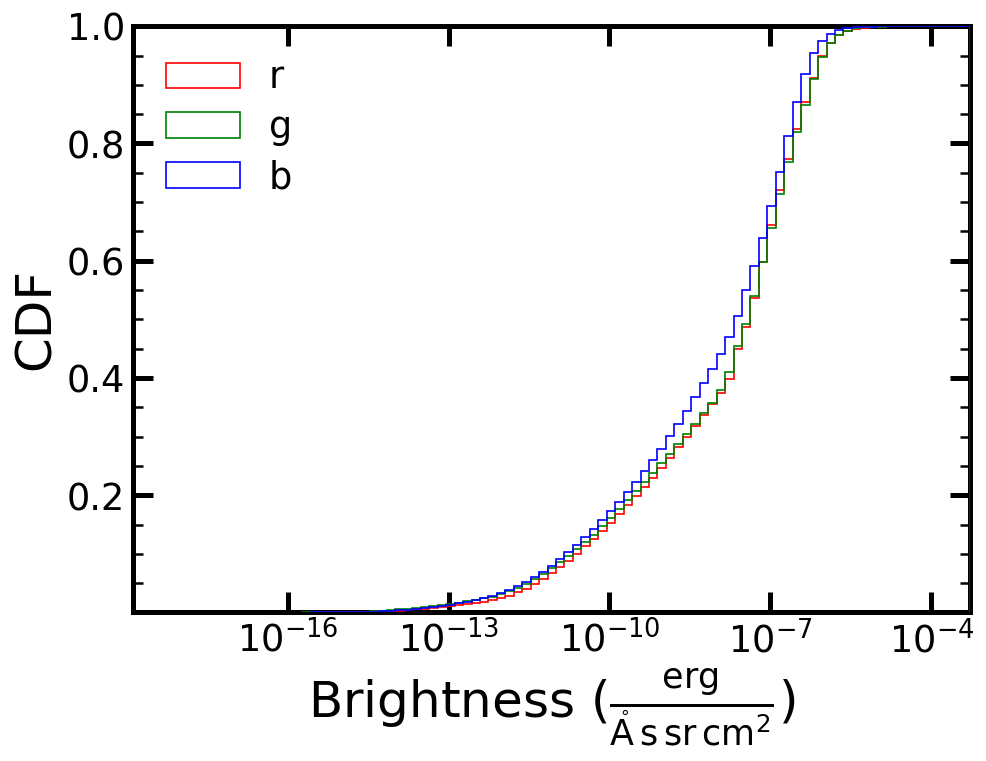

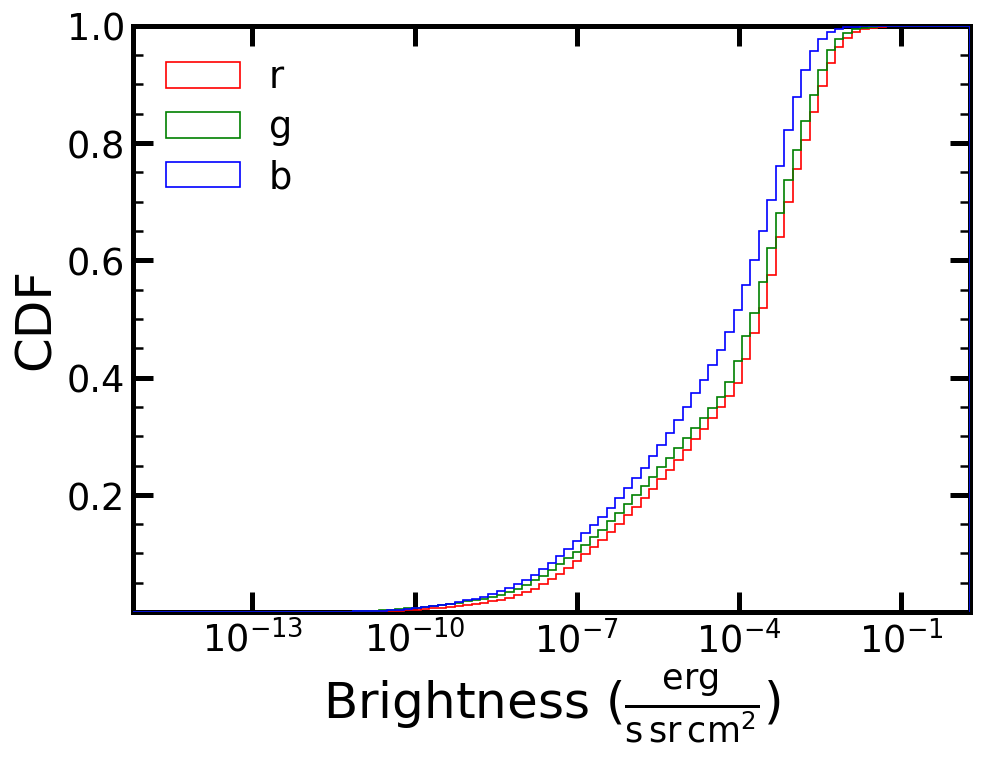

In [127]:
inst.make_rgb_hist(rgb_filters, brightness_units='frequency')
inst.make_rgb_hist(rgb_filters, brightness_units='wavelength')
inst.make_rgb_hist(rgb_filters, brightness_units='neutral')

Now we will make an RGB image for each with some preset stretch values tuned for each.

Image brightness is in terms of frequency with units MJy / sr
Image brightness is in terms of frequency with units MJy / sr
Image brightness is in terms of frequency with units MJy / sr
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (Angstrom s sr cm2).
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (Angstrom s sr cm2).
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (Angstrom s sr cm2).
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (s sr cm2).
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (s sr cm2).
Image brightness is in terms of frequency with units MJy / sr
Image brightness units converted to erg / (s sr cm2).


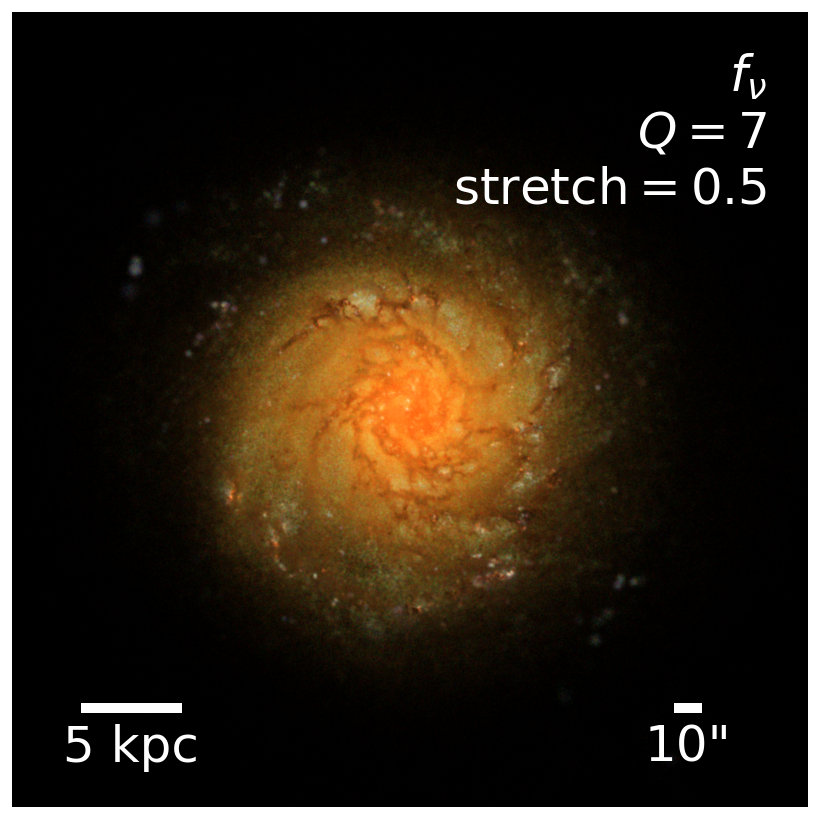

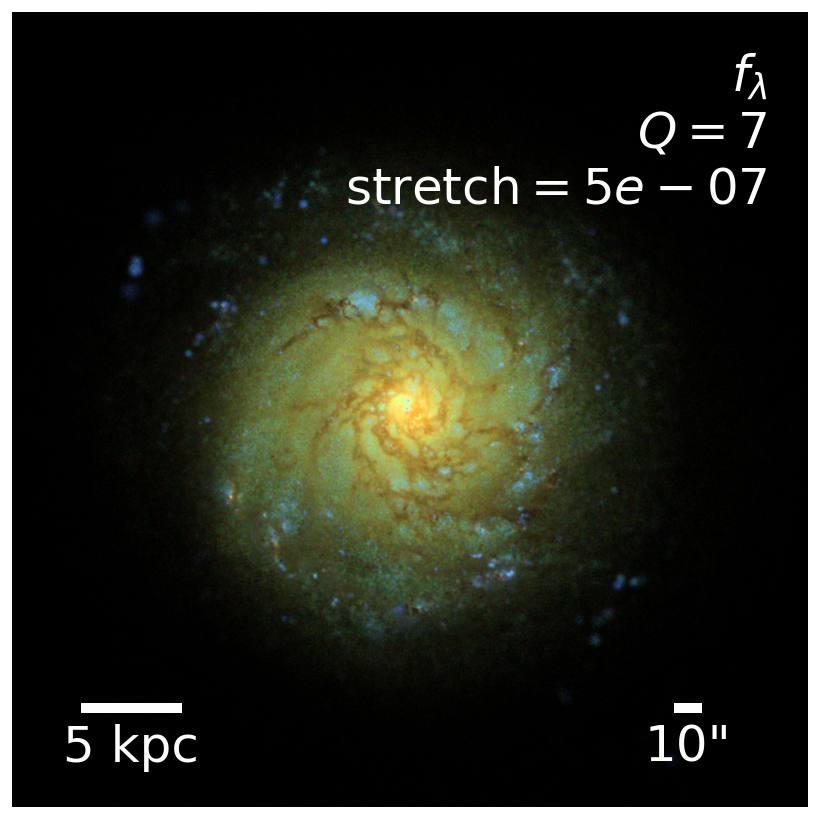

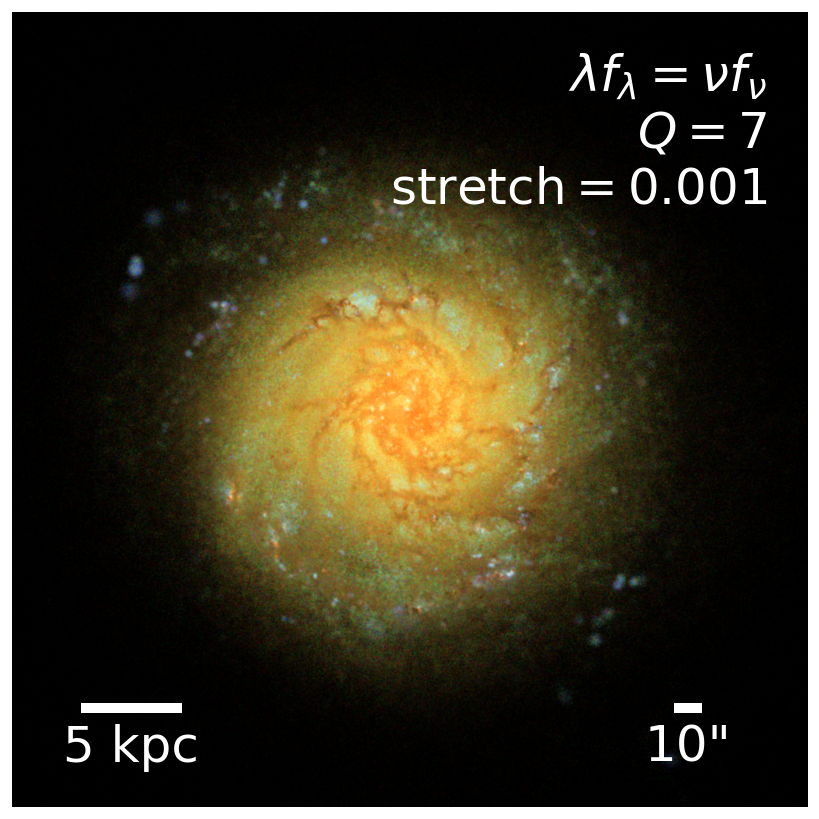

In [131]:
stretch=0.5 # smaller values increase the dynamic range. If your image is black set this very small 
Q=7 # This sets the brightest parts of the image
minimum=0 # This sets the minimum pixel value that is clipped to black
label=r'$f_{\nu}$' '\n' r'$Q=%i$' '\n' r'${\rm stretch}=%g$' % (Q,stretch)
inst.make_lupton_RGB_image(rgb_filters, stretch = stretch, Q=Q, minimum=minimum, brightness_units='frequency', label=label, output_name=None)


stretch=0.0000005 # smaller values increase the dynamic range. If your image is black set this very small 
Q=7 # This sets the brightest parts of the image
minimum=0 # This sets the minimum pixel value that is clipped to black
label=r'$f_{\lambda}$' '\n' r'$Q=%i$' '\n' r'${\rm stretch}=%g$' % (Q,stretch)
inst.make_lupton_RGB_image(rgb_filters, stretch = stretch, Q=Q, minimum=minimum, brightness_units='wavelength', label=label, output_name=None)


stretch=0.001 # smaller values increase the dynamic range. If your image is black set this very small 
Q=7 # This sets the brightest parts of the image
minimum=0 # This sets the minimum pixel value that is clipped to black
label=r'$\lambda f_{\lambda} = \nu f_{\nu}$' '\n' r'$Q=%i$' '\n' r'${\rm stretch}=%g$' % (Q,stretch)
inst.make_lupton_RGB_image(rgb_filters, stretch = stretch, Q=Q, minimum=minimum, brightness_units='neutral', label=label, output_name=None)

## Convolving with a PSF

Real telescopes smear out point sources due to optics wizardy. To account for this we can make a mock PSF for our instrument and convolve our image with the PSF. 

For simple cases a Gaussian PSF with the telescope resolution should suffice.

Currently the only 'real' PSFs are for JWST MIRI and NIRCam taken from the `webb_psf` python module.

Below we create a PSF for each SDSS filter assuming a 1 arcsec resolution per pixel. In practice this resolution will change based on the distance to the target and its redshift.

In [10]:

filter_psf=[]
# Get PSF for each filter
# Right now only JWST MIRI and NIRCam PSFs are implemented
# Any unsupported filter will assume a Gaussian PSF scaled with a specified resolution as done below
telescope_res = 1 # arcsec
oversample_factor=4 # This is the oversampling factor for the PSF, 4 is the default and should do fine

print(inst.pixel_res_arcsec)

for filter in rgb_filters:
    psf = Telescope_PSF(inst, filter, verbose=True)  
    filter_psf += [psf.get_psf(telescope_res = telescope_res, 
                oversample_factor=oversample_factor)]

0.1999495093
PSF model for filter GENERIC has pixel scale 1 arcsec / pixel.

PSF model for filter GENERIC has pixel scale 1 arcsec / pixel.

PSF model for filter GENERIC has pixel scale 1 arcsec / pixel.



Now let's plot that same RGB image again convolved over the PSFs we calculated. All we have to do is provided the PSFs to the `psf` function argument.

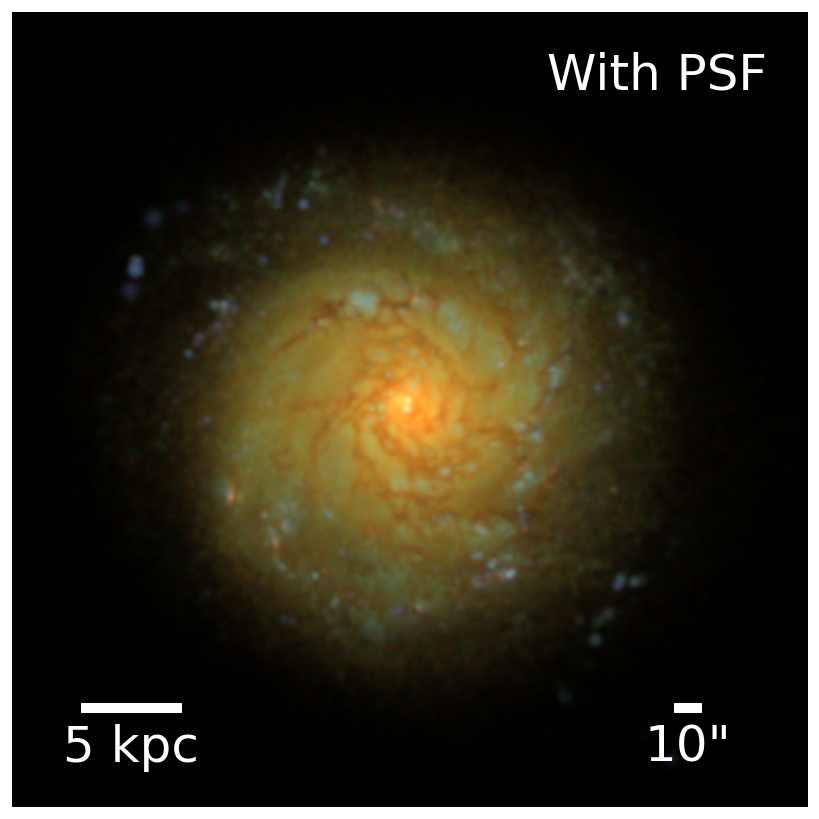

In [11]:
stretch=0.5 # smaller values increase the dynamic range
Q=10 # sets the bright features
minimum=0 # minimum pixel value that is clipped to black
label='With PSF'
inst.make_lupton_RGB_image(rgb_filters, psf=filter_psf, stretch = stretch, Q=Q, minimum=minimum, neutral_units=True, label=label, output_name=None)

## Adding Background Noise

Real telescopes have a minimum detectable magnitude/brightness due to either atmospheric effects for ground-based telescopes or the exposure time for space-based telescopes. This is an oversimplification since there are things like dark current space-basted telescopes have to worry about, but ignoring these details is fine for our purposes.

Below we will add background noise to the image.